# **A Gentle Introduction to Supervised Deep Learning** [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/1LoNp7Ib44DakkvFt3ToGDUgk8BUqqCwn)

### *By Jack Foster - www.twitter.com/JackFosterML*


*Much of this work is inspired by "Pattern Recognition and Machine Learning", Bishop 2006 and "Deep Learning", Goodfellow et al 2016*.

# Preface
This tutorial notebook is designed to provide a gentle introduction to supervised machine learning for those with a reasonable mathematical background and who are somewhat familiar with basic programming, but possess little knowledge of the machine learning landscape. The sections to this notebook are sequential and build upon one another, and are split into the following:


1.   Introduction
2.   Scientific Python
3.   Simple Linear Regression
3.   OLS Linear Regression
4.   The Perceptron
5.   Neural Networks
6.   PyTorch
7.   Convolutional Neural Networks
8.   Graph Neural Networks


In my opinion, the hardest-to-grasp section is probably the Linear Regression part, as once this is understood, subsequent topics become rather intuitive.

It should be noted that this tutorial will be rather pragmatic, it is by no means comprehensive and may propose certain intuitions that are perhaps imperfect, but offer useful insight into ML for beginners. We will focus on the common supervised learning problems of classification and regression, ignoring unsupervised, reinforcement, or generative problems.

*The first few sections are rather dry and maths-y, with few-to-no code snippets. Apologies for the book-style beginning, but a strong initial intuition is important for when we get to the good stuff!*




# Introduction
The field of machine learning and pattern recognition is concerned with the ***automatic*** discovery of regularities in data through the use of computer algorithms and with the use of these regularities to take actions such as classifying the data into different categories (Bishop 2006). Here, automatic is the operative word.

Early approaches to many AI problems involved rule-based methods - relying on human expertise to define heuristics or rules that an AI could use to make decisions. Such methods work for systems that have known, formalised, mathematical rules; but rarely found success in complex environments - for a variety of reasons - but mainly due to many real-world domains being governed by either an innumerable amount of rules *or* by a set of rules that are unknown or intractable.

Modern methods, from the simplest linear regression right up to deep learning, reduce the reliance on human *hand-crafted* rulesets, and most commonly replace them with data-driven approaches, allowing them to *learn* solutions to problems from experience. This takes many forms and can be interpreted in many different ways. One way to view ML is that it attempts to learn either a function, or the parameters of some function, such that it can appropriately solve a given problem. For example, image classification may be seen as the task of learning a function that, given some matrix of pixels $A \in \mathbb{R}^{m \times n}$, correctly maps $A$ to the class $c$ within a finite set of classes $C \in \{0, ..., n\}$. As we'll see later, an alternative and very common way of viewing machine learning is to view it as a probabilistic endeavour, but for now the key intuition is to think of machine learning as trying to automatically find or optimise some function to best solve some problem, most commonly by fitting said function to some data.

Finally, most supervised machine learning problems can be loosely fit into the problems of classification or regression problems.

Classification, as in the example above, attempts to map some input $x$ (of arbitrary dimensions) to some discrete unordered output $y$. For example, identifying whether the image is of a cat or a dog is classification, as we take an image (i.e. a matrix of pixels) as input and try to predict either 'Cat' or 'Dog' (or rather in practice, some numerical representation of the classes such as class 0 or 1).

In contrast, regression problems are those that attempt to map some input $x$ (of arbitrary dimensions) to some continuous valued output $y$. For example, predicting the cost of a house from the date it was built and its number of bedrooms is regression as cost is a continuous variable.

For both problems, an input vector $X$ contains a set of *features* that may be useful for solving the task. In the regression example, $X$ would be a vector $[date,num\_beds]$ and for some sample from the dataset $x_{i} = [1950,3]$. Here,the input vector would be said to have 2 features.

# Scientific Python

This tutorial, like much of the machine learning community, will rely heavily upon the scientific Python libraries: Numpy, SciPy, SciKit-learn Matplotlib, and (eventually) PyTorch. PyTorch is a library specifically for deep learning and is discussed is greater detail later.

Numpy offers support for large, multi-dimensional arrays and matrices, along with a large collection of high-level mathematical functions.

SciPy and SciKit offer a range of machine learning functions, including prebuilt models (e.g. a decision tree), datasets, and metrics.

Finally, Matplotlib is a useful for visualising data and producing figures.

We will be using these throughout the tutorial, so familiarity with them will be beneficial. If you're not familiar, don't worry, code will be explained as it is presented.

# A Note On Overfitting

 Machine learning often overfits to its training data (i.e. can near-perfectly solve a problem for data it trains on, but can't solve for unseen tasks), so we *always* measure the performance of a model by witholding data and evaluting its performance on that (train/test split). This ensures it can generalise to new data. Often we will split data in 3, one set is for training, the validation set is for evaluating when to stop training - the model doesn't train on it but its performance on this set is evaluated periodically to ensure the model is still generalising. Finally, the test set is never seen at all by the model until the training has stopped, and then its performance is evaluated at the very end on this.

# Simple Linear Regression

The next section covers a more powerful version of linear regression, and it covers some critical nuances that a key in ML. But first, to find our feet, we will cover an extremely simple version that still highlights many critical concepts in machine learning.

You should be familiar with the classic straight line equation $y = mx + c$, where the gradient is defined by $m$ and the y-intercept by $c$. This equation can be viewed as a predictive tool, as given the equation, we can accurately map some new value of $x$ to its associated $y$ value.

Suppose we have a data set, $\mathcal{D} = \{(x_1,y_1), ..., (x_n,y_n)\}$, and we want to model the relationship between the $x$ and $y$ values (an important thing to note is that there is almost always noise in data, so the datapoints will have some added randomness to them). We want to use a simple straight line, but we don't know the values for $m$ and $c$!  How can we find them? Well, we just need to choose values that give us the predictions, $\hat{y}$, that are closest to the actual value $y$. To do this, we need a way of measuring our error.

Most commonly, we will use mean square error. Simply, the difference between our prediction and the true value is given by $y-\hat{y}$ (this is called a residual). And so the total error across all predictions is give by:

$E = \sum_{i=0}^{N} (y_{i} - \hat{y}_{i})$

The problem here is that error has direction, and so positive error will cancel out negative error. To solve this, we typically square the residuals:

$E = \frac{1}{2}\sum_{i=0}^{N} (y_{i} - \hat{y}_{i})^2$

The $\frac{1}{2}$ at the front is a normalising constant, which is present for reasons you'll see in a moment.

Now that we have our error, all we need to do is minimise it. How to do that? Well recall:

$\hat{y} = mx + c$

$\therefore E = \frac{1}{2}\sum_{i=0}^{N} (y_{i} - mx_i -c)^2$

given that we can't control the $x$ value, we can only change $m$ and $c$ to optimise our predictions. Observe that our loss function has no maximum, but does have a minimum, and therefore the error is minimised when its derivative is 0. We can therefore find the optimum $m$ and $c$ by taking the derivative of the error w.r.t the parameter:


$\frac{dE}{dc} = \sum_{i=0}^{n} y_i-c-mx_i$

set equal to zero to find minima...

$0 = \sum_{i=0}^{n} y_i-c-mx_i$

solve for c...

$\sum_{i=0}^{n} c = \sum_{i=0}^{n} (y_i - mx_i)$

$\sum_{i=0}^{n} c = nc$

$\therefore c = \frac{\sum_{i=0}^{n} (y_i - mx_i)}{n}$

sum of samples over number of samples is the mean:

$\therefore c = \bar{y} - m\bar{x}$

Now we have our y-intercept, we can solve for $m$:


$\frac{dE}{dm} = \frac{1}{2} \sum_{i=0}^{n} 2x_{i}(y_i -c-mx_{i})$

$\frac{dE}{dm} = \sum_{i=0}^{n} x_{i}(y_i - c-mx_{i})$

$0 = \sum_{i=0}^{n} x_{i}(y_i - c - mx_{i})$

substitute $c$:

$0 = \sum_{i=0}^{n} x_{i}(y_i - (\bar{y} - m\bar{x}) -mx_{i})$

$0 = \sum_{i=0}^{n} x_{i}(y_i - \bar{y} + m\bar{x} -mx_{i})$

$0 = \sum_{i=0}^{n} x_{i}(y_i - \bar{y}) + \sum_{i=0}^{n} x_{i}(m\bar{x} -mx_{i})$

$0 = \sum_{i=0}^{n} x_{i}(y_i - \bar{y}) + m\sum_{i=0}^{n} x_{i}(\bar{x} -x_{i})$

$m\sum_{i=0}^{n} x_{i}(\bar{x} -x_{i}) = - \sum_{i=0}^{n} x_{i}(y_i - \bar{y})$

$m= - \frac{\sum_{i=0}^{n} x_{i}(y_i - \bar{y})}{\sum_{i=0}^{n} x_{i}(\bar{x} -x_{i}) }$

$m= \frac{\sum_{i=0}^{n} x_{i}(\bar{y} - y_i)}{\sum_{i=0}^{n} x_{i}(x_{i} - \bar{x}) }$

Lets see how well these values do!


In [ ]:
#Import some of the libraries mentioned in section 2
import matplotlib.pyplot as plt
import matplotlib.animation as anim
import matplotlib as mpl
from IPython.display import HTML
import numpy as np
from sklearn import datasets

mpl.rcParams['figure.dpi'] = 130

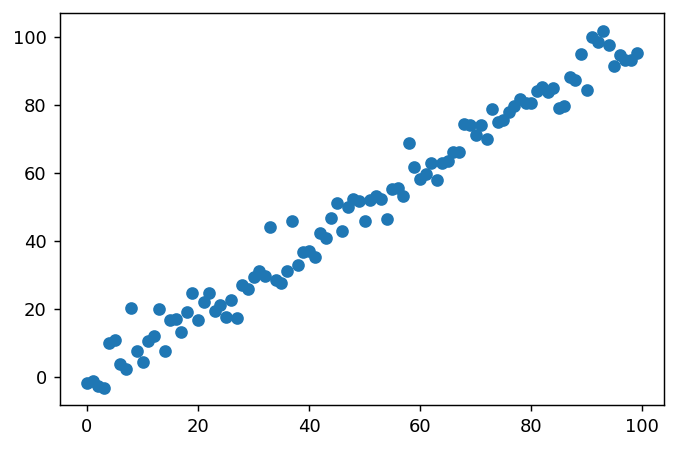

In [ ]:
#Generate example dataset
x = np.arange(100)
y = x + np.random.normal(0,5,len(x))

plt.scatter(x,y)

In [ ]:
y_mean = np.mean(y)
x_mean = np.mean(x)

#find m
numerator = sum([(x_*y_)-(y_mean*x_) for x_,y_ in zip(x,y)])
denominator = sum([(x_**2)-(x_mean*x_) for x_ in x])
m = numerator/denominator

#c = y¯−mx¯
c = np.mean(y) - m*np.mean(x)

Text(0.5, 0, 'X')

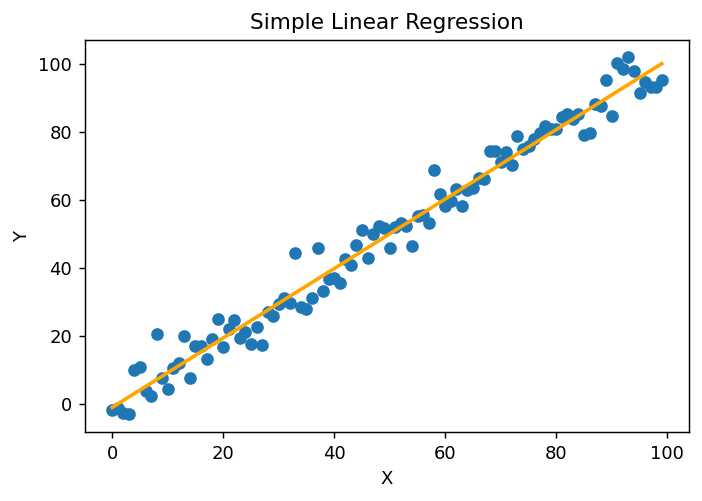

In [ ]:
plt.scatter(x,y)
plt.plot(x,(m*x)+c,color='orange',lw=2)
plt.title('Simple Linear Regression')
plt.ylabel('Y')
plt.xlabel('X')

# Ordinary Least Squares Linear Regression

Ordinary Least Squares Linear Regression is a statistical method that attempts to predict some dependent variable $Y$, given some independent variables $X$.

Consider some data $D=\{(x_{1},y_{1},...,(x_{n},y_{n})\}$. Each $(x,y)$ pair is a sample within the dataset. While we will consider $y$ to be a continuous, real value, each $x$ could infact be a vector of multiple features. For example, each sample's $x$ may contain 2 values denoting the year a house was built and its number of bedrooms.

Our goal is to model the relationship between $X$ and $Y$ as a function such that $y_{i} \approx f(w, x_{i})$, where $w$ is a set of unknown parameters.

The simplest linear regression model is:

$f(w, x_{i}) = w_{i0} + w_{1} x_{i1} + ... + w_{n} x_{in}$

where n is the length of the $x$ vector and $x_{i0}$ denotes the $0$th element of the $i$th $x$ sample. However, linear regression only constrained to be linear in the unknown parameters $w$, and so a set of basis functions may exist to manipulate $x$, provided they do not apply to any $w$:

$f(w, x_{i}) = w_{0} + w_{1} \phi_{1} (x_{i}) + ... + w_{n} \phi_{n}(x_{i})$

$f(w, x_{i}) =w_{0} + \sum_{j=0}^{n}w_{j} \phi_{j} (x_{i})$


Note that $x_{i}$ here is the full $x$ feature vector for sample $i$. $w_{0}$ is a bias parameter and will become critical later. Let us rewrite this in matrix form such that $W$ is the matrix of parameters, and $\Phi$ is a matrix of all $\phi$:

$f(w,x) = w^T \Phi(x)$



A common choice of basis function is a set of polynomials such that:

$f(w, x_{i}) = w_{0} + \sum_{j=0}^{n}w_{j} (x_{i})^j$



In a perfect world, the function $f$ would perfectly model the data generating process and thus perfectly predict all $y$ given their corresponding $x$ value. However, in practice, this is rarely an achievable goal due to the presence of noise or errors in the data presenting some notion of randomness. Under this assumption of randomness, we can say that if $f$ perfectly represents the underlying process then:

$y_{i} = f(w, x_{i}) + \epsilon$

where $\epsilon$ is a random number drawn from some probability density function. Under this probabilistic view, we can present the model:

$p(y|x,w,\sigma^2) = \mathcal{N}(y|f(x,w), \sigma^2)$

What are we actually modelling here? Well if we look at it, its actually a likelihood function that is representing "what is the likelihood that the independent variable takes the value $y$, given we know $x$, we have a variance $\sigma^2$ and our model parameters are $w$?" As $\sigma$ and $x$ are not being altered by our predictive model, we can deduce that the optimal parameters $w^*$ would maximise this probability.

Recall our dataset $\mathcal{D} = \{(y_i , x_i)\}_{i=0}^N$. If we assume these datapoints were drawn independently from the normal distribution, we can rewrite our likelihood as:


$p(y|x,w,\sigma^2) = \prod_{n=1}^{N} \mathcal{N}(y_{n}|f(x,w), \sigma^2)$

Now recall that $f(w,x) = w^T \Phi(x)$

and thus we can state:

$p(y|x,w,\sigma^2) = \prod_{n=1}^{N} \mathcal{N}(y_{n}|w^T \phi(x_{n}), \sigma^2)$

Recall the equation for the Gaussian distribution is given by:

$\mathcal{N}(x|\mu,\sigma^2) = \frac{1}{(2\pi \sigma^2)^{\frac{1}{2}}}\exp^{-\frac{1}{2\sigma^2}(x-\mu)^2}$

Considering this, if we take the logarithm of the likelihood fucntion we arrive at:

$\ln[ p(y|x,w,\sigma^2)] = -\frac{N}{2}\ln(2\pi \sigma^2) - \frac{1}{2\sigma^2}\sum_{i=1}^{N}(y_{i}-w^T\phi (x_{i}))^2$

From here we can make a few observations. Firstly, recall that the only thing we can change within our model is the parameters $w$ and as such the first term can be ignored. The second term, ignoring the $\pi \sigma^2$ in the denominator, is actually what we would call the least squares error, and it is the sum of the squared error between our prediction and the ground truth value. $y_{i}-w^T\phi (x_{i})$ is the difference between the ground truth dependent variable $y_{i}$, and our prediction for that value. A function that calculates how wrong our prediction is, is often called a *loss function*:

$\mathcal{L}_{LSE}(w) = \sum^{n}_{i=1}(y_{i}-w^T\phi (x_{i}))^2$

This is a critical idea that crops up throughout all machine learning. Given a loss function, in this case the least squares error, the goal is to choose parameters that minimise that loss.

Observe that the LSE loss has no maximum value but, as it is squared, has a minimum value. Thus, taking the derivative with respect to $w$ and setting equal to $0$ will give us the minima (note we drop the $\pi \sigma^2$ as scaling by a positive constant coefficient does not alter the location of the maximum with respect to $w$):

$\nabla \ln p(y|w,\sigma^2) = \sum_{i=1}^{N}(y_{i}-w^T\phi (x_{i}))(\phi (x_{i}))^T$

$\therefore 0 = \sum_{i=1}^{N}(y_{i}-w^T\phi (x_{i}))(\phi (x_{i}))^T$

solving for w...

$w = (\Phi^T \Phi)^-1 \Phi^Ty$

where $\Phi_{ij} = \phi_{j}(x_i)$ and $w$ is the vector of parameters

As we can see, we have now arrived at the optimal solution for w that will best fit the data. In a moment, we will look at a slightly more practical version that is applied to more complex methods. But for now, lets see this implemented in code! This time, we'll use a real-world dataset where we try to predict the progression of diabetes 1 year after diagnosis, using just the patient's BMI.



In [ ]:
diabetes_features = np.array(datasets.load_diabetes().feature_names)
print(datasets.load_diabetes().DESCR)

#We want to only use BMI to predict diabetes
bmi_idx = np.where(diabetes_features=='bmi')[0][0]

#Load diabetes dataset from sklearn
diabetes_X, diabetes_y = datasets.load_diabetes(return_X_y=True)

# Use only one feature. select bmi
diabetes_X = diabetes_X[:, np.newaxis, bmi_idx]

# Split the data into training/testing sets
diabetes_X_train = diabetes_X[:-40]

diabetes_X_test = diabetes_X[-40:]

# Split the targets into training/testing sets
diabetes_y_train = diabetes_y[:-40]
diabetes_y_test = diabetes_y[-40:]

.. _diabetes_dataset:

Diabetes dataset
----------------

Ten baseline variables, age, sex, body mass index, average blood
pressure, and six blood serum measurements were obtained for each of n =
442 diabetes patients, as well as the response of interest, a
quantitative measure of disease progression one year after baseline.

**Data Set Characteristics:**

  :Number of Instances: 442

  :Number of Attributes: First 10 columns are numeric predictive values

  :Target: Column 11 is a quantitative measure of disease progression one year after baseline

  :Attribute Information:
      - age     age in years
      - sex
      - bmi     body mass index
      - bp      average blood pressure
      - s1      tc, total serum cholesterol
      - s2      ldl, low-density lipoproteins
      - s3      hdl, high-density lipoproteins
      - s4      tch, total cholesterol / HDL
      - s5      ltg, possibly log of serum triglycerides level
      - s6      glu, blood sugar level

Note: Each of these 1

In [ ]:
#Phi is the matrix of X values, in this instance taken to increasing powers such that we have x^0, x^1, x^2
phi = np.array([np.ones(diabetes_X_train.shape), \
                diabetes_X_train,np.power(diabetes_X_train,2)]).T.squeeze()



In [ ]:
#Calculate our W values
print(phi.shape, diabetes_y_train.shape)
denom = np.matmul(phi.transpose(), phi)
numer = np.matmul(phi.transpose(), diabetes_y_train)
w = np.matmul(np.linalg.inv(denom),numer)

w.shape

(402, 3) (402,)


(3,)

Text(0.5, 1.0, 'Training Data')

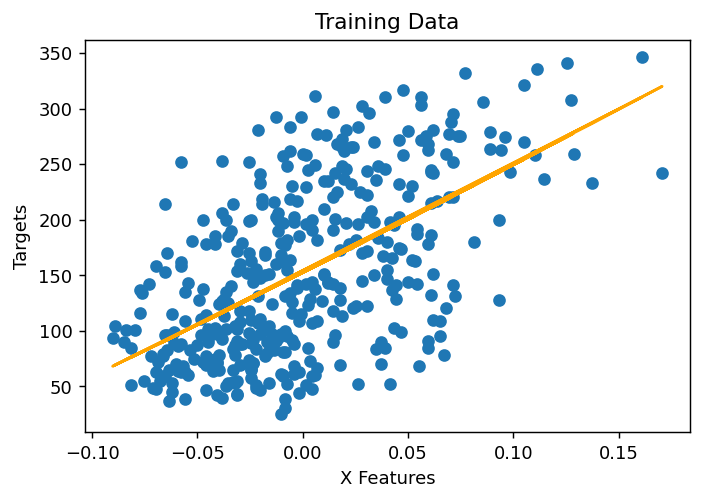

In [ ]:
#Plot performance on training data
analytic_train_preds = np.matmul(phi,w)
plt.scatter(diabetes_X_train,diabetes_y_train)
plt.plot(diabetes_X_train, analytic_train_preds, color='orange')
plt.ylabel('Targets')
plt.xlabel('X Features')
plt.title('Training Data')

Text(0.5, 1.0, 'Test Data')

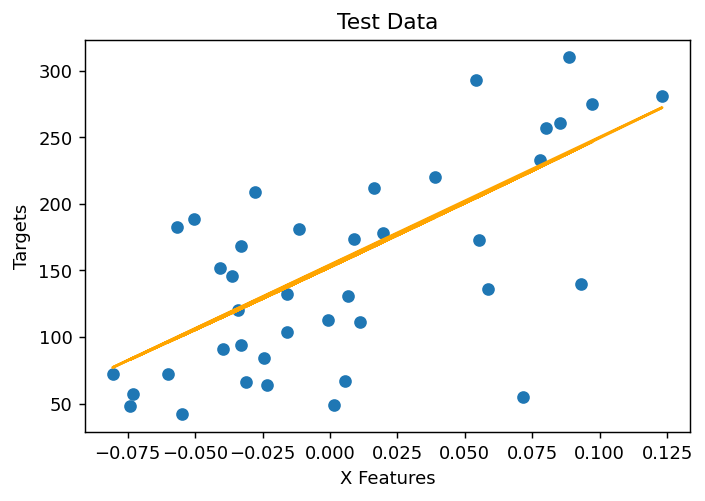

In [ ]:
phi = np.array([np.ones(diabetes_X_test.shape), \
                diabetes_X_test,np.power(diabetes_X_test,2)]).T.squeeze()

analytic_test_preds = np.matmul(phi,w)
plt.scatter(diabetes_X_test,diabetes_y_test)
plt.plot(diabetes_X_test, analytic_test_preds, color='orange')
plt.ylabel('Targets')
plt.xlabel('X Features')
plt.title('Test Data')

# Stochastic Gradient Descent

Now we have seen how to arrive at the optimal parameter values analytically. However imagine the case where we have millions or billions of parameters/basis functions, and the same number of training samples. Very quickly it becomes infeasible to solve this problem in this way. Furthermore, as we will see later, more complex models have no known closed solution.

Instead, we will now look at the iterative approach to solving this through gradient descent, which allows the optimisation of the parameters over a sequential stream of samples from $\mathcal{D}$, which means its also appropriate for realtime operation.

The general idea is actually (in my opinion) much simpler than the above approach. Recall the least squares loss function

$\mathcal{L}(w)= \sum_{i=0}^{N}(y_{i}-w\phi (x_{i}))^{2}$

The idea is simple, we initialise each parameter randomly, and then we find the rate of change of loss w.r.t each parameter and then update that parameter accordingly:

$w^{t+1} = w^t + \eta \nabla \mathcal{L}(w)$

Thus:

$w^{t+1} = w^t + \eta \nabla (y_{i}-w^T\phi (x_{i}))\phi (x_{i})$

Note, as we are learning sequentially $\eta <1$ ensures our model doesn't learn *too much* from one single sample, and that we make gradual changes.

In [ ]:
def update_params(w, phi,y,learning_rate = 0.01):
  pred_ = np.matmul(w, phi.T)

  loss = y - pred_
  loss = np.matmul(loss, phi)
  w = np.add(w, (learning_rate * loss))
  return w

In [ ]:
def loss(w,phi,y):
  l = 0.5*((y-np.matmul(w, phi.T))**2)
  return l

In [ ]:
epochs = 330
num_w = 3
running_loss = []
running_preds = []
#Initialise to whatever, here I'm doing 1/polynomial for no particular reason
w = np.expand_dims(np.array([1 for n in range(num_w)]), axis=0)
for epoch in range(epochs):
  loss_ = 0
  for x,y in zip(diabetes_X_train, diabetes_y_train):
    if isinstance(y, float):
      y = np.array([y])
    phi = np.array([np.ones(x.shape), \
                x,np.power(x,2)]).T
    w = update_params(w,phi,y)
    loss_ += sum(loss(w,phi,y))

  phi = np.array([np.ones(diabetes_X_test.shape), \
                diabetes_X_test,np.power(diabetes_X_test,2)]).T.squeeze()
  preds_ = np.matmul(w, phi.T).squeeze()
  running_preds.append(preds_)
  running_loss.append(loss_)
print(f'w values: {w}')


w values: [[156.19167378 899.56194007  27.26654119]]


In [ ]:
mpl.rc('animation', html='jshtml')

fig,ax = plt.subplots()

def animate(i):
  ax.clear()
  title= ax.set_title(f'Gradient Descent Learning: Epoch {i}')
  scat = ax.scatter(diabetes_X_test,diabetes_y_test)
  ax.plot(diabetes_X_test,analytic_test_preds, lw=2, label='Analytic Solution',color='orange')
  plot = ax.plot(diabetes_X_test,running_preds[i], lw=2, label='Gradient Descent', color='b')
  ax.legend()
  return (plot)

ani = anim.FuncAnimation(fig,animate,frames=len(running_preds), interval=35,blit=False, repeat=True)
plt.close()

In [ ]:
%matplotlib inline
ani

Text(0.5, 0, 'Epoch')

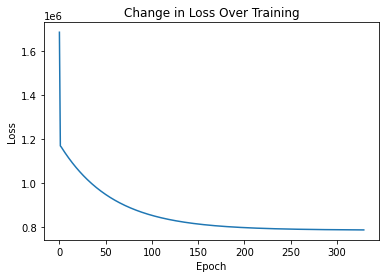

In [ ]:
plt.plot(range(epochs), running_loss)
plt.title('Change in Loss Over Training')
plt.ylabel('Loss')
plt.xlabel('Epoch')

Notice how we approach the near-optimum, but don't necessarily arrive at the *true* optimum.

Henceforth, we shall endeavour to keep the mathematics to a minimum, using it only where absolutely necessary.

# The Perceptron

The perceptron is the building block of neural networks. It can be thought of as a crude mathematical abstraction of a human neuron.

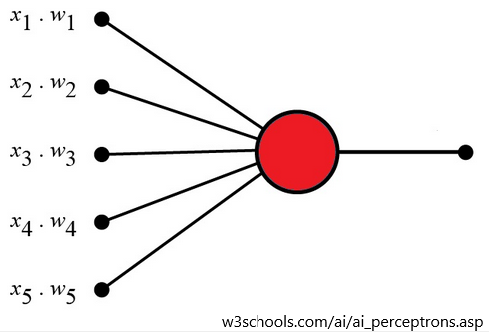


A perceptron takes a set of inputs in, weights them, and then provides some output based on these input. Below we will implement two simple perceptrons, one that acts as an OR gate and one that acts as an AND gate.

In [ ]:
class Perceptron():
  def __init__(self,num_inputs):
    self.weights = np.ones(num_inputs)

  def OR_activation_function(self,inputs:np.array):
    ins = self.weights*inputs
    return 0 if sum(ins) < 1 else 1

  def AND_activation_function(self,inputs:np.array):
    ins = self.weights*inputs
    return 0 if sum(ins) < len(inputs) else 1


perc = Perceptron(2)

inputs = np.array([1,0])

print(f'OR Gate: {perc.OR_activation_function(inputs)}')
print(f'AND Gate: {perc.AND_activation_function(inputs)}')

OR Gate: 1
AND Gate: 0


This class has two methods, the first is acting as an OR gate (output 1 if any input is at least 1) and the second is an AND gate (output 1 if ALL inputs are at least 1.

Here, the problems are so trivial we actually don't need weights (thus they are instantiated to 1, and are never updated). In other problems, we would learn the weights (and optionally a bias parameter) in much the same way we conducted linear regression.

The choice of activation function here seems like the most important decision. In practice, for larger models, there tends to be one of a few empirically chosen activation functions that can be used to solve a huge range of tasks (such as the Sigmoid, ReLU, or TanH functions).

You should notice that this approach with a single perceptron is incredibly limited in what it can accomplish. For example, it is impossible to model an XOR gate with a perceptron, as the classes are not linearly separable (unlike AND gates and OR gates).

# Neural Networks
The simplest neural network is what we call a Multi-layer perceptron. This model is simply a set of stacked layers, where each layer is comprised of $n$  perceptrons, and they feedforward in a fully connected manner (see the image below).

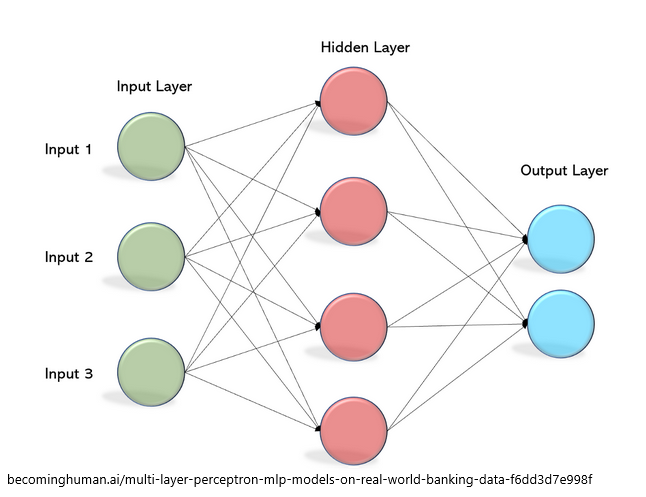

Each perceptron (or node, or neuron) acts the same way as above, only this time using more generic activation functions. Neural networks are comprised of an input layer, an output layer, and an arbitrary number of "hidden layers" between them.

A good way of understanding neural networks is to consider them as a universal function approximator. That is, neural networks are able to model any function (given sufficient model depth and width), and it is useful to think of them simply as a parameterised function, $f(\theta)$ who's goal is to maximise the likelihood $p(y|x,\theta)$. In otherwords, given some input $x$, the model will learn a set of parameters $\theta$ (i.e. the weights and bias terms), to maximise the likelihood of $y$. A probabilistic understanding of neural networks is very useful, but beyond the scope of this notebook. We direct the reader to Bishop 2006 for a stronger probabilistic understanding of machine learning.

One of the most (if not THE most) important advancements in the field of machine learning is that of backpropagation. Backpropagation is essentially the clever application of the chain rule to calculate the partial derivative of the error function w.r.t each parameter within the network, allowing for the effective training of neural networks. This is important as because layers feed into each other, it is very hard to otherwise calculate how early weights are affecting the final prediction. Here we shall derive the backprop algorithm, before implementing a simple neural net.

Let use once more use the mean square error function. let $w^k_{ij}$ be the weight between node $j$ in the $k-1$ layer and node $i$ in layer $k$, and let $\sigma(x)$ denote some activation function applied to $x$.

Therefore, the activation of a neuron is:

$a^k_j = \sigma (\sum_j w^k_{ij} a^{k-1}_{j}+b^k_j)$

or in vectorised form:

$a^k = \sigma(w^ka^{k-1} + b^k)$

For clarity, let $z = w^ka^{k-1} + b^k$
$\therefore a^k = \sigma(z)$

If we now consider the very last layer (the output layer), $a^k$, then we can say the loss of the network $C = (a^k - y)^2$. In order to change our final output, we can tune the weights and biases within the network. To calculate how much to change these, we can utilise the chain rule:

$\frac{\delta c}{\delta w^k} = \frac{\delta z^k}{\delta w^k}\frac{\delta a^k}{\delta z^k}\frac{\delta c}{\delta a^k}$

Calculating these derivatives...

$\frac{\delta c}{\delta a^k} = 2(a^k-y)$

$\frac{\delta a^k}{\delta z^k} = \sigma'(z^k)$

$\frac{\delta z^k}{\delta w^k} = a^{k-1}$

We can repeat this process for the biases too.

The derivation above is for a two layered network with only 1 neuron in each layer. To make this a more complete process that can be applied to depth and width of arbitrary length, we can firstly make the cost a summation:

$C = \sum_{j=0}^{n}(a^k_{j} - y_j)^2$

Then, our $z$ would just become the sum of all the inputs coming from the previous layer, not just a single one:

$z = ... + w_{ij}^ka^{k-1}_{ij} + b_{ij}^k + ...$

and thus we can find the loss contribution of a single parameter via:

$\frac{\delta c}{\delta w^k_{ij}} = \frac{\delta z^k_j}{\delta w^k_{ij}}\frac{\delta a^k_j}{\delta z^k_j}\frac{\delta c}{\delta a^k_j}$

We'll leave backprop there, but hopefully you have a good intuition around the idea now.


While we could implement neural nets by hand, in practice this is not only laborious, but also limiting as many of the processes are computationally expensive. As such, it is more common to leverage libraries to enable speed of development, and to ensure the models run efficiently. There are several libraries to choose from, but we will focus on PyTorch.

# PyTorch

As with everything else in this notebook, we will only provide a very brief overview of PyTorch, and there are plenty of resources available online should you wish to learn more. At its core, these kind of libraries offer 3 or 4 key things that aren't available elsewhere. We'll see these things implemented in the coming code snippets, but first lets look at the barebones functionality.

In [ ]:
import torch, torchvision
import torch.nn as nn
import torchvision.transforms as  transforms

## Tensors

Tensors are like fancy arrays. They do all the things your numpy arrays do:

In [ ]:
T1 = torch.arange(10)
T1

tensor([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [ ]:
print(f'We can add scalars to tensors elementwise: {T1 + 5}')
print(f'\nWe can multiply tensors by scalars elementwise: {5*T1}')

We can add scalars to tensors elementwise: tensor([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14])

We can multiply tensors by scalars elementwise: tensor([ 0,  5, 10, 15, 20, 25, 30, 35, 40, 45])


In [ ]:
"""
the * operator acts as the Hadamaard product (i.e. elementwise)
"""

T2 = torch.arange(10)
print(f'\nWe can multiply tensors by each other (vectors): {T1*T2}')

T3 = torch.stack((torch.arange(10),torch.arange(10)))

print(f'\nWe can multiply tensors by each other (matrix by vector):\n{T3*T1}')

T4 = torch.stack((2*torch.arange(10),2*torch.arange(10)))

print(f'\nWe can multiply tensors by each other (matrix by matrix):\n{T3*T4}')


We can multiply tensors by each other (vectors): tensor([ 0,  1,  4,  9, 16, 25, 36, 49, 64, 81])

We can multiply tensors by each other (matrix by vector):
tensor([[ 0,  1,  4,  9, 16, 25, 36, 49, 64, 81],
        [ 0,  1,  4,  9, 16, 25, 36, 49, 64, 81]])

We can multiply tensors by each other (matrix by matrix):
tensor([[  0,   2,   8,  18,  32,  50,  72,  98, 128, 162],
        [  0,   2,   8,  18,  32,  50,  72,  98, 128, 162]])


In [ ]:
"""
the .matmul operator acts as the matrix product (i.e. elementwise)
"""


print(f'\nWe can multiply tensors by each other (matrix by vector):\n{torch.matmul(T3,T1)}')

print(f'\nWe can multiply tensors by each other (matrix by matrix):\n{torch.matmul(T3,T4.T)}')


We can multiply tensors by each other (matrix by vector):
tensor([285, 285])

We can multiply tensors by each other (matrix by matrix):
tensor([[570, 570],
        [570, 570]])


We can do alot more with Tensors, and you can use the pytorch docs to find specific functions

## Datasets and DataLoaders

Code for handling data can quickly get messy and hard to manage.

Fast processing of large datasets is also tricky.

PyTorch offers wrappers for data processing tasks in the form of Datasets and Dataloaders.

In [ ]:
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets
batch_size = 4

trainset = datasets.CIFAR10(root='./data', train=True,
                                        download=True, transform=transform)

trainloader = DataLoader(trainset, batch_size=batch_size,
                                          shuffle=True, num_workers=2)

testset = datasets.CIFAR10(root='./data', train=False,
                                       download=True, transform=transform)
testloader = DataLoader(testset, batch_size=batch_size,
                                         shuffle=False, num_workers=2)


In [ ]:
for x,y in trainloader: # x is input data, y is label
  continue

In [ ]:
import os
import pandas as pd
from torchvision.io import read_image
# Taken from https://pytorch.org/tutorials/beginner/basics/data_tutorial.html
class CustomImageDataset(Dataset):
    def __init__(self, annotations_file, img_dir, transform=None, target_transform=None):
        self.img_labels = pd.read_csv(annotations_file)
        self.img_dir = img_dir
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.img_labels.iloc[idx, 0])
        image = read_image(img_path)
        label = self.img_labels.iloc[idx, 1]
        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            label = self.target_transform(label)
        return image, label

We can also add transforms to our data, such as flipping images

## Models
A convenient part of PyTorch is that the majority of model architectures can be built using prebuilt substructures. For example, to implement a simple feed forward neural network we can build one using a series of Linear layers:

In [ ]:
class MLP(nn.Module):
  def __init__(self, in_features, out_features):
    super(MLP, self).__init__()

    self.model = nn.Sequential(nn.Linear(in_features,80),
                               nn.ReLU(),
                               nn.Linear(80,80),
                               nn.ReLU(),
                               nn.Linear(80,80),
                               nn.ReLU(),
                               nn.Linear(80,out_features))

  def forward(self,x):
    x = self.model(x)
    return x

You can see self.model defines the network architecture. It has an input layer, a hidden layer, and an output layer, with a ReLU activation function between each.

We can now run data through the model to get a prediction.
For this example, we'll do classification, thus the output layer is N-length and each element of the output corresponds to a specific class. The goal is to maximise the output at the node reflecting the correct class for a given input, and minimise everywhere else.

In [ ]:
#Generate some random data
data = torch.rand(40)
label = torch.randint(10, size=(1,1))

#Instantiate Model
mlp = MLP(40, 10)


#Get output
out = mlp(data)
out

tensor([-0.1096,  0.1141, -0.0557, -0.1460, -0.0440, -0.0164,  0.0158, -0.0380,
        -0.0863,  0.0199], grad_fn=<AddBackward0>)

## Autograd

A huge part of PyTorch and TensorFlow is the autograd functionality - an automatic differentiation engine that powers the neural network training process.

Notice above how the tensor has a grad_fnc tag. Essentially, autograd facilitates the use of backprop and is going to keep a track of the gradients for each parameter in the model.

Let's have a look at this

In [ ]:
#Using a loss function
loss_func = nn.CrossEntropyLoss()

#label is the ground truth
loss = loss_func(out, label.squeeze())

print("Before Backward Pass:\n")
for n,p in mlp.named_parameters():
  print(f'{n} Gradient: {p.grad}')
print('##############################################################\n\n')

loss.backward()
print("After Backward Pass:\n")
for n,p in mlp.named_parameters():
  print(f'{n} Gradient: {p.grad}')

Before Backward Pass:

model.0.weight Gradient: None
model.0.bias Gradient: None
model.2.weight Gradient: None
model.2.bias Gradient: None
model.4.weight Gradient: None
model.4.bias Gradient: None
model.6.weight Gradient: None
model.6.bias Gradient: None
##############################################################


After Backward Pass:

model.0.weight Gradient: tensor([[ 0.0048,  0.0080,  0.0018,  ...,  0.0062,  0.0063,  0.0007],
        [-0.0020, -0.0033, -0.0008,  ..., -0.0026, -0.0026, -0.0003],
        [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
        ...,
        [ 0.0016,  0.0026,  0.0006,  ...,  0.0020,  0.0021,  0.0002],
        [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
        [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000]])
model.0.bias Gradient: tensor([ 0.0089, -0.0037,  0.0000,  0.0094,  0.0000,  0.0000,  0.0213,  0.0000,
         0.0000,  0.0000, -0.0022,  0.0000,  0.0020,  0.0134, -0.0013,  0.0156,
         0.0094,

So now we have our gradients, we want to update the weights. How can we do this? Well its very easy, we use an optimiser which will do it for us:

## Optimization

Once we have the gradients, PyTorch also handles the updating of the model parameters using popular optimization algorithms like stochastic gradient descent  (SGD), or adaptive moment estimation (Adam)​

In [ ]:
opt = torch.optim.SGD(mlp.parameters(), lr=1e-2, momentum=0.9)

opt.step()

## Putting it all Together

And that, really, is the whistle stop tour of PyTorch fundamentals. Below we'll imeplement a full training process on some real data and highlight a few more useful things PyTorch offers.

First, PyTorch offers hardware acceleration functionality, making it trivial to run code on a GPU, all you have to do is move your model + your data onto the gpu device (see below).


Finally, DataLoaders are essentially a fast and useful way of getting data into a useful format for making predictions.

In [ ]:
#Check if GPU is available
device = 'cuda' if torch.cuda.is_available() else 'cpu'

"""
Notice throughout the following code, you'll see .to(device) following certain statements.
That is there to allow GPU compute
"""

"\nNotice throughout the following code, you'll see .to(device) following certain statements.\nThat is there to allow GPU compute\n"

*Quick note, if you're using Colab and want a GPU go to Runtime->Change runtime type->Set Hardware accelerator to GPU*

Running on a GPU substantially improves speed

*Code demo adapted
 from here:
www.pytorch.org/tutorials/beginner/blitz/cifar10_tutorial.html*

In [ ]:
#Little bit of preprocessing
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

batch_size = 4

trainset = torchvision.datasets.CIFAR10(root='./data', train=True,
                                        download=True, transform=transform)

trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                          shuffle=True, num_workers=2)

testset = torchvision.datasets.CIFAR10(root='./data', train=False,
                                       download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size,
                                         shuffle=False, num_workers=2)


classes = ('plane', 'car', 'bird', 'cat',
           'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

Files already downloaded and verified
Files already downloaded and verified


In [ ]:
img,label = next(iter(trainset))

#Shape is 3x32x32
print(img.shape)

in_features = 3*32*32
out_features = len(classes)

mlp = MLP(in_features,out_features).to(device)


torch.Size([3, 32, 32])


In [ ]:
loss_fnc = nn.CrossEntropyLoss()
opt = torch.optim.SGD(mlp.parameters(), lr=0.002, momentum=0.9)

In [ ]:
num_epochs = 2
#Training
for epoch in range(num_epochs):
  for data in trainloader:
    img,label = data[0].to(device), data[1].to(device)
    img = torch.flatten(img,start_dim=1,end_dim=3)
    #Zero out any left over gradients
    opt.zero_grad()

    prediction = mlp(img)
    loss = loss_fnc(prediction, label)
    loss.backward()
    opt.step()

In [ ]:
#Lets evaluate on test set
total,correct =0,0

#No training
with torch.no_grad():
  for data in testloader:
    img,label = data[0].to(device), data[1].to(device)
    img = torch.flatten(img,start_dim=1,end_dim=3)
    prediction = mlp(img)
    _,predicted = torch.max(prediction.data, 1)
    total+=label.size(0)
    correct += (predicted==label).sum().item()

mlp_score =100*correct/total
print(f'Accuracy of the network on the test set: {mlp_score}%')

Accuracy of the network on the test set: 45.84%


Just finally, I'd like to finish by highlighting that different models are just tools for us to use properly.

In the above example, we used a feedforward neural network for image classification. In reality, this is a very poor method for solving such a task and we would rather use Convolutional Neural Networks, as they utilise spatiality in the input vector and maintain small weight matrices (for reasons beyond this tutorial).

The final code snippets below just show an implementation of a CNN for the same task, and highlight how much better they can do.

In [ ]:
class CNN(nn.Module):
  def __init__(self):
    super().__init__()
    self.conv = nn.Sequential(nn.Conv2d(3, 6, 5),
                               nn.ReLU(),
                               nn.MaxPool2d(2, 2),
                               nn.Conv2d(6, 16, 5),
                               nn.ReLU(),
                               nn.MaxPool2d(2, 2))

    self.fc = nn.Sequential(nn.Linear(16 * 5 * 5, 120),
                            nn.ReLU(),
                            nn.Linear(120, 10))

  def forward(self, x):
      x = self.conv(x)
      x = torch.flatten(x, 1) # flatten all dimensions except batch
      x = self.fc(x)
      return x

In [ ]:
cnn = CNN().to(device)

In [ ]:
loss_fnc = nn.CrossEntropyLoss()
opt = torch.optim.SGD(cnn.parameters(), lr=0.002, momentum=0.9)

In [ ]:
num_epochs = 2
#Training
for epoch in range(num_epochs):
  for data in trainloader:
    img,label = data[0].to(device), data[1].to(device)
    #Zero out any left over gradients
    opt.zero_grad()

    prediction = cnn(img)
    loss = loss_fnc(prediction, label)
    loss.backward()
    opt.step()

In [ ]:
#Lets evaluate on test set
total,correct =0,0

#No training
with torch.no_grad():
  for data in testloader:
    img,label = data[0].to(device), data[1].to(device)
    prediction = cnn(img)
    _,predicted = torch.max(prediction.data, 1)
    total+=label.size(0)
    correct += (predicted==label).sum().item()
cnn_score =  100*correct/total
print(f'Accuracy of the network on the test set: {cnn_score}%')

Accuracy of the network on the test set: 51.64%


Text(0.5, 0, 'Models')

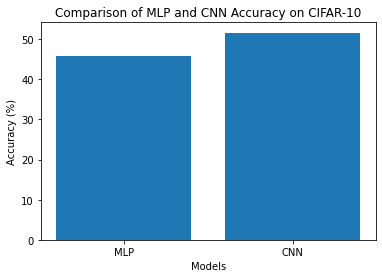

In [ ]:
fig,ax= plt.subplots()
ax.bar([1,2], [mlp_score, cnn_score])
ax.set_xticklabels(['MLP','CNN'])
ax.set_xticks([1,2])
ax.set_title('Comparison of MLP and CNN Accuracy on CIFAR-10')
ax.set_ylabel('Accuracy (%)')
ax.set_xlabel('Models')